## How extract N-Grams

### Initial Configuration

In [1]:
import nltk
nltk.download('book')
from nltk.book import *
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px

[nltk_data] Downloading collection 'book'
[nltk_data]    | 
[nltk_data]    | Downloading package abc to /home/jean/nltk_data...
[nltk_data]    |   Package abc is already up-to-date!
[nltk_data]    | Downloading package brown to /home/jean/nltk_data...
[nltk_data]    |   Package brown is already up-to-date!
[nltk_data]    | Downloading package chat80 to /home/jean/nltk_data...
[nltk_data]    |   Package chat80 is already up-to-date!
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /home/jean/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package conll2000 to
[nltk_data]    |     /home/jean/nltk_data...
[nltk_data]    |   Package conll2000 is already up-to-date!
[nltk_data]    | Downloading package conll2002 to
[nltk_data]    |     /home/jean/nltk_data...
[nltk_data]    |   Package conll2002 is already up-to-date!
[nltk_data]    | Downloading package dependency_treebank to
[nltk_data]    |     /home/jean/nltk_data..

*** Introductory Examples for the NLTK Book ***
Loading text1, ..., text9 and sent1, ..., sent9
Type the name of the text or sentence to view it.
Type: 'texts()' or 'sents()' to list the materials.
text1: Moby Dick by Herman Melville 1851
text2: Sense and Sensibility by Jane Austen 1811
text3: The Book of Genesis
text4: Inaugural Address Corpus
text5: Chat Corpus
text6: Monty Python and the Holy Grail
text7: Wall Street Journal
text8: Personals Corpus
text9: The Man Who Was Thursday by G . K . Chesterton 1908


### Bi-Grams

* Pairs of words that occur consecutively. 

In [2]:
md_bigrams = list(bigrams(text1))
fdist = FreqDist(md_bigrams)

Here we can obtain the most frequent bi-grams in this text: 

In [3]:
fdist.most_common(10)

[((',', 'and'), 2607),
 (('of', 'the'), 1847),
 (("'", 's'), 1737),
 (('in', 'the'), 1120),
 ((',', 'the'), 908),
 ((';', 'and'), 853),
 (('to', 'the'), 712),
 (('.', 'But'), 596),
 ((',', 'that'), 584),
 (('.', '"'), 557)]

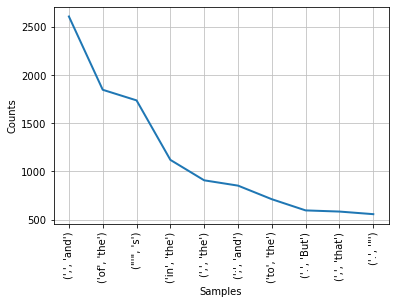

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [4]:
fdist.plot(10)

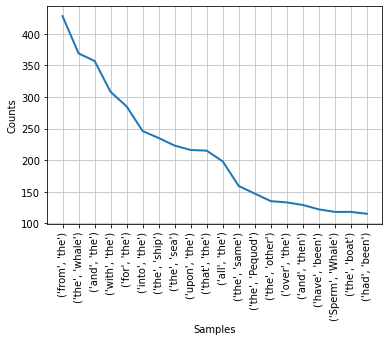

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [5]:
threshold = 2
filtered_bigrams = [bigram for bigram in md_bigrams if len(bigram[0])>threshold and len(bigram[1])>threshold]
filtered_bigrams = FreqDist(filtered_bigrams)
filtered_bigrams.plot(20)

### Tri-Grams

In [6]:
from nltk.util import ngrams
md_trigrams = list(ngrams(text1, 3))
fdist = FreqDist(md_trigrams)
fdist.most_common(10)

[((',', 'and', 'the'), 187),
 (('don', "'", 't'), 103),
 (('of', 'the', 'whale'), 101),
 ((',', 'in', 'the'), 93),
 ((',', 'then', ','), 87),
 (('whale', "'", 's'), 81),
 (('.', 'It', 'was'), 81),
 (('ship', "'", 's'), 80),
 (('the', 'Sperm', 'Whale'), 77),
 ((',', 'as', 'if'), 76)]

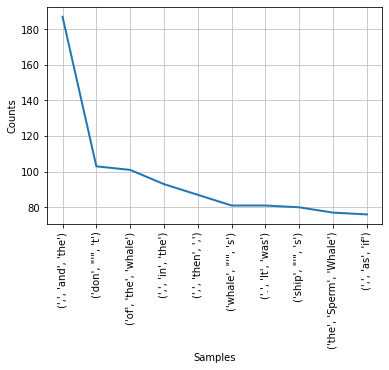

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [7]:
fdist.plot(10)

# Collocations

* They are sequences of words that usually occur in texts or conversations with an ** unusually high frequency **  [NLTK doc](http://www.nltk.org/book/ch01.html)
* Word collocations are formal statements of where that word is typically located.  [Manning & Schütze, 1990, Foundations of Statistical Natural Language Processing, Capítulo 6](https://nlp.stanford.edu/fsnlp/)

In [8]:
md_bigrams = list(bigrams(text1))

threshold = 2
#distribution of bi-grams
filtered_bigrams = [bigram for bigram in md_bigrams if len(bigram[0])>threshold and len(bigram[1])>threshold]
filtered_bigram_dist = FreqDist(filtered_bigrams)
#distribution of words
filtered_words = [word for word in text1 if len(word)>threshold]
filtered_word_dist = FreqDist(filtered_words)

df = pd.DataFrame()
df['bi_gram'] = list(set(filtered_bigrams))
df['word_0'] = df['bi_gram'].apply(lambda x: x[0])
df['word_1'] = df['bi_gram'].apply(lambda x: x[1])
df['bi_gram_freq'] = df['bi_gram'].apply(lambda x: filtered_bigram_dist[x])
df['word_0_freq'] = df['word_0'].apply(lambda x: filtered_word_dist[x])
df['word_1_freq'] = df['word_1'].apply(lambda x: filtered_word_dist[x])
df

,bi_gram,word_0,word_1,bi_gram_freq,word_0_freq,word_1_freq
0,"(The, counterpane)",The,counterpane,1,612,6
1,"(the, condensed)",the,condensed,1,13721,2
2,"(made, you)",made,you,1,178,841
3,"(cities, and)",cities,and,1,3,6024
4,"(few, long)",few,long,1,92,318
...,...,...,...,...,...,...
67937,"(the, heron)",the,heron,1,13721,2
67938,"(body, for)",body,for,1,110,1414
67939,"(deep, pang)",deep,pang,1,69,1
67940,"(were, ready)",were,ready,4,680,40


# Pointwise Mutual Information (PMI)
A metric based on _information theory_ to find  **Collocations**.

$$
PMI = \log\left(\frac{P(w_1, w_2)}{P(w_1)P(w_2)}\right)
$$

In [9]:
df['PMI'] = df[['bi_gram_freq', 'word_0_freq', 'word_1_freq']].apply(lambda x:np.log2(x.values[0]/(x.values[1]*x.values[2])), axis = 1)
df['log(bi_gram_freq)'] = df['bi_gram_freq'].apply(lambda x: np.log2(x))
df


,bi_gram,word_0,word_1,bi_gram_freq,word_0_freq,word_1_freq,PMI,log(bi_gram_freq)
0,"(The, counterpane)",The,counterpane,1,612,6,-11.842350,0.0
1,"(the, condensed)",the,condensed,1,13721,2,-14.744098,0.0
2,"(made, you)",made,you,1,178,841,-17.191695,0.0
3,"(cities, and)",cities,and,1,3,6024,-14.141469,0.0
4,"(few, long)",few,long,1,92,318,-14.836445,0.0
...,...,...,...,...,...,...,...,...
67937,"(the, heron)",the,heron,1,13721,2,-14.744098,0.0
67938,"(body, for)",body,for,1,110,1414,-17.246926,0.0
67939,"(deep, pang)",deep,pang,1,69,1,-6.108524,0.0
67940,"(were, ready)",were,ready,4,680,40,-12.731319,2.0


In [10]:
df.sort_values(by = 'PMI', ascending = False)

,bi_gram,word_0,word_1,bi_gram_freq,word_0_freq,word_1_freq,PMI,log(bi_gram_freq)
63810,"(oppositely, voided)",oppositely,voided,1,1,1,0.000000,0.0
7799,"(overburdening, panniers)",overburdening,panniers,1,1,1,0.000000,0.0
21081,"(occult, lessons)",occult,lessons,1,1,1,0.000000,0.0
10981,"(Pale, Sherry)",Pale,Sherry,1,1,1,0.000000,0.0
17242,"(lassitude, overtakes)",lassitude,overtakes,1,1,1,0.000000,0.0
...,...,...,...,...,...,...,...,...
2159,"(man, the)",man,the,1,508,13721,-22.732783,0.0
52238,"(some, the)",some,the,1,578,13721,-22.919024,0.0
30362,"(one, the)",one,the,1,889,13721,-23.540138,0.0
34256,"(the, not)",the,not,1,13721,1103,-23.851315,0.0


In [ ]:
fig = px.scatter(x = , y = , color = , hover_name=)

In [12]:
fig = px.scatter(x = df['PMI'].values, y = df['log(bi_gram_freq)'].values, color = df['PMI']+df['log(bi_gram_freq)'], 
                 size = (df['PMI']+df['log(bi_gram_freq)']).apply(lambda x: 1/(1+abs(x))).values, 
                 hover_name = df['bi_gram'].values, width = 600, height = 600, labels = {'x': 'PMI', 'y': 'Log(Bigram Frequency)'})
fig.show()

# Pre-built measures in NLTK 

In [13]:
# see https://www.nltk.org/_modules/nltk/metrics/association.html
from nltk.collocations import *
bigram_measure = nltk.collocations.BigramAssocMeasures()
finder = BigramCollocationFinder.from_words(text1)

In [14]:
finder.apply_freq_filter(20)
finder.nbest(bigram_measure.pmi, 10)

[('Moby', 'Dick'),
 ('Sperm', 'Whale'),
 ('White', 'Whale'),
 ('Right', 'Whale'),
 ('Captain', 'Peleg'),
 (',"', 'said'),
 ('never', 'mind'),
 ('!"', 'cried'),
 ('no', 'means'),
 ('each', 'other')]

# Text in Spanish

In [15]:
# download corpus in spanish https://mailman.uib.no/public/corpora/2007-October/005448.html
nltk.download('cess_esp')
corpus = nltk.corpus.cess_esp.sents()
flatten_corpus = [w for l in corpus for w in l]

[nltk_data] Downloading package cess_esp to /home/jean/nltk_data...
[nltk_data]   Package cess_esp is already up-to-date!


In [18]:
print(flatten_corpus[:100])
print(len(flatten_corpus))

['El', 'grupo', 'estatal', 'Electricité_de_France', '-Fpa-', 'EDF', '-Fpt-', 'anunció', 'hoy', ',', 'jueves', ',', 'la', 'compra', 'del', '51_por_ciento', 'de', 'la', 'empresa', 'mexicana', 'Electricidad_Águila_de_Altamira', '-Fpa-', 'EAA', '-Fpt-', ',', 'creada', 'por', 'el', 'japonés', 'Mitsubishi_Corporation', 'para', 'poner_en_marcha', 'una', 'central', 'de', 'gas', 'de', '495', 'megavatios', '.', 'Una', 'portavoz', 'de', 'EDF', 'explicó', 'a', 'EFE', 'que', 'el', 'proyecto', 'para', 'la', 'construcción', 'de', 'Altamira_2', ',', 'al', 'norte', 'de', 'Tampico', ',', 'prevé', 'la', 'utilización', 'de', 'gas', 'natural', 'como', 'combustible', 'principal', 'en', 'una', 'central', 'de', 'ciclo', 'combinado', 'que', 'debe', 'empezar', 'a', 'funcionar', 'en', 'mayo_del_2002', '.', 'La', 'electricidad', 'producida', 'pasará', 'a', 'la', 'red', 'eléctrica', 'pública', 'de', 'México', 'en_virtud_de', 'un', 'acuerdo', 'de', 'venta']
192686


In [19]:
finder = BigramCollocationFinder.from_documents(corpus)
finder.apply_freq_filter(10)
finder.nbest(bigram_measure.pmi, 10)

[('señora', 'Aguirre'),
 ('secretario', 'general'),
 ('elecciones', 'generales'),
 ('campaña', 'electoral'),
 ('quiere', 'decir'),
 ('Se', 'trata'),
 ('segunda', 'vuelta'),
 ('director', 'general'),
 ('primer', 'ministro'),
 ('primer', 'lugar')]